In [2]:
import os
import sys

data_fitting_py_files_dir = os.path.abspath("../../py_files/")
sys.path.insert(0, data_fitting_py_files_dir)

helper_func_py_files_dir = os.path.abspath("../../../../vampires_on_sky_calibration/programs/py_files/")
sys.path.insert(0, helper_func_py_files_dir)

import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import minimize
import general
import data_plotting
import reading_data
import instrument_matrices


In [3]:
HWP_angs = np.array([0., 11.25, 22.5, 33.75, 45., 56.25, 67.5, 78.75])
IMR_angs = np.array([45., 57.5, 70., 82.5, 95., 107.5, 120., 132.5])
wavelengths = np.array([625, 675, 725, 750, 775])
angles = [HWP_angs, IMR_angs]

In [4]:
# Last index is for choosing the wavelength

wavelength_index = 3
wavelength = 750

double_differences = np.load("../../../data/20230914/double_diffs_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
double_sums = np.load("../../../data/20230914/double_sums_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
double_difference_errs = np.load("../../../data/20230914/double_diff_stds_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
double_sum_errs = np.load("../../../data/20230914/double_sum_stds_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
data = np.array([double_differences, double_sums])
stds = np.array([double_difference_errs, double_sum_errs])

reshaped_data = general.reshape_and_flatten(data)
reshaped_stds = general.reshape_and_flatten(stds)

In [5]:
# NOTE: Customized angle bounds for each parameter
IMR_angle_bound = 1
LP_angle_bound = 5
HWP_angle_bound = 5
FLC_angle_bound = (-5, 5)

bounds = ((0, 1), # EM Gain Ratio
          (-1 * LP_angle_bound, LP_angle_bound), # linear polarizer angle (degrees)
          (-1, 1), # delta_FLC (waves)
          (-1, 1), # delta_opt (waves)
          (-1, 1), # delta_derot (waves)
          (0, 0.499999), # delta_HWP (waves)
          FLC_angle_bound, # rot_FLC (degrees)
          (-90, 90), # rot_opt (degrees)
          (-1 * IMR_angle_bound, IMR_angle_bound), # offset_derot (degrees)
          (-1 * HWP_angle_bound, HWP_angle_bound), # offset_HWP (degrees)
          (0, 1)) # epsilon_opt (unitless)

# Plot Initial Guess

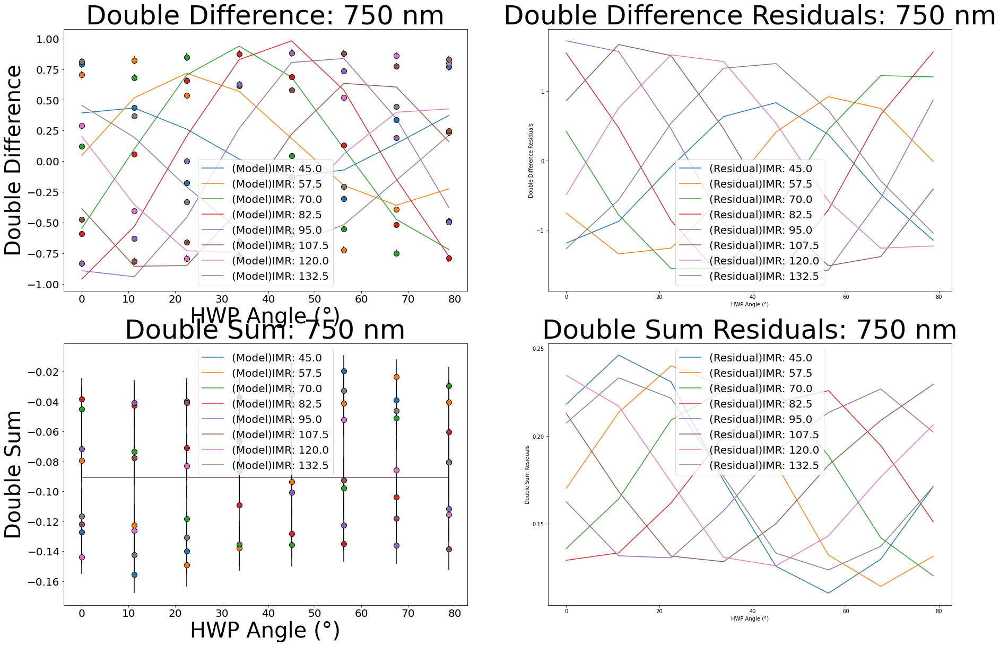

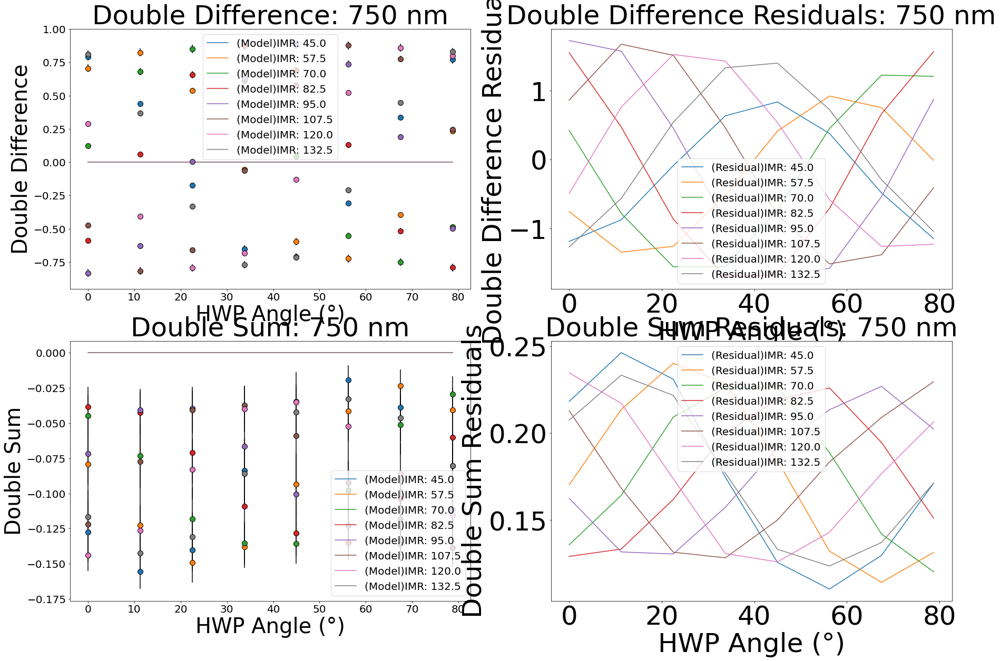

In [8]:
# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# Choosing matrix model
model = instrument_matrices.full_system_mueller_matrix

# Based on values in Six_And_Eleven_Parameter_Model_Best_MCMC_and_Scipy_Fits - having zeros for angles that're too large
theta_pol = 0
delta_m3 = 0 # (waves) - assumed to be a perfect mirror for now
epsilon_m3 = 0  # Using the M3 diattenuation from :all_unpolarized_standards_matrix_inversion_m3_diatttenuation"
offset_m3 = 0  # NOTE: Made this zero too for testing purposes
em_gain = 1.2  # Add your actual em_gain value
delta_HWP = 0.451  # Add your actual delta_HWP value
offset_HWP = -2.642  # Add your actual offset_HWP value
delta_derot = 0.32  # Add your actual delta_derot value
offset_derot = 0  # Add your actual offset_derot value
delta_opts = 0  # Add your actual delta_opts value
epsilon_opts = 0  # Add your actual epsilon_opts value
rot_opts = 0  # Add your actual rot_opts value
delta_FLC = 0.5  # Add your actual delta_FLC value
rot_FLC = 0  # Add your actual rot_FLC value

initial_guess = np.array([ \
    theta_pol,
    delta_HWP,
    offset_HWP,
    delta_derot,
    offset_derot,
    delta_opts,
    epsilon_opts,
    rot_opts,
    delta_FLC,
    rot_FLC,
    em_gain
])

fixed_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Calculating initial model and residuals
initial_model = instrument_matrices.internal_calibration_mueller_matrix(theta_pol,
    model, fixed_params, HWP_angs, IMR_angs)
initial_residuals = initial_model - reshaped_data

# Plotting the initial model and residuals
data_plotting.plot_single_model_and_residuals(angles, angles, -initial_model, data, 
    initial_residuals, stds, log_f, wavelength, fig_dimensions = (30, 20))

# Plotting just the data with no model
data_plotting.plot_single_model_and_residuals(angles, angles, np.zeros(np.shape(initial_model)), data, 
    initial_residuals, stds, log_f, wavelength, fig_dimensions = (30, 20))

# FLC ~ HWP behaviour and FLC angle restrained from -5 to 5 degrees, HWP and IMR basically restrained

Initial Likelihood: 24203.17419185138
Iteration #1: 320.57927121544753
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -0.2716923838728129
delta_HWP (waves): 0.44623194623523
offset_HWP (degrees): 3.779211905185335
delta_derot (waves): 0.4862789903352511
offset_derot (degrees): 3.06026542299948
delta_opts (waves): 0.11651359635496672
epsilon_opts: 0.0007444902484791782
rot_opts (degrees): -2.830460727961036
delta_FLC (waves): 0.4808484549282688
rot_FLC (degrees): 5.0
em_gain: 1.1551279212387549


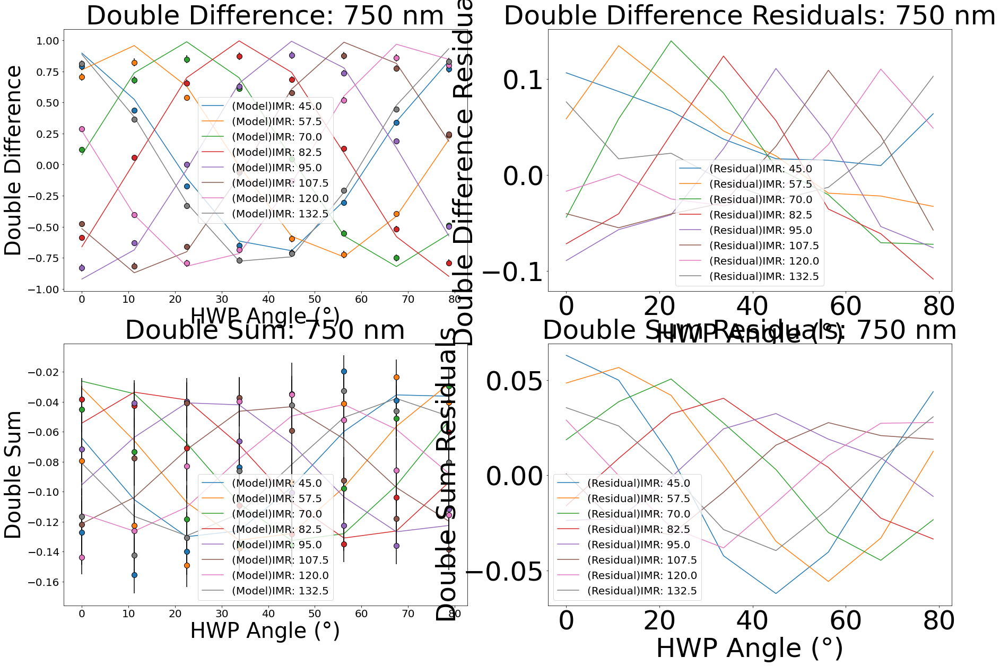

Post Likelihood: 320.57927121544753
Initial Likelihood: 645.2990416890365
Iteration #2: -1499.3533168377853
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -0.181094643896213
delta_HWP (waves): 0.46961046668665407
offset_HWP (degrees): 2.698798762612448
delta_derot (waves): 0.49023757764051257
offset_derot (degrees): -4.987432156588005
delta_opts (waves): 0.2576688302301876
epsilon_opts: 0.0004945113361748126
rot_opts (degrees): -5.410322914796492
delta_FLC (waves): 0.4846776606181207
rot_FLC (degrees): 4.980600354913346
em_gain: 1.1879418569186648


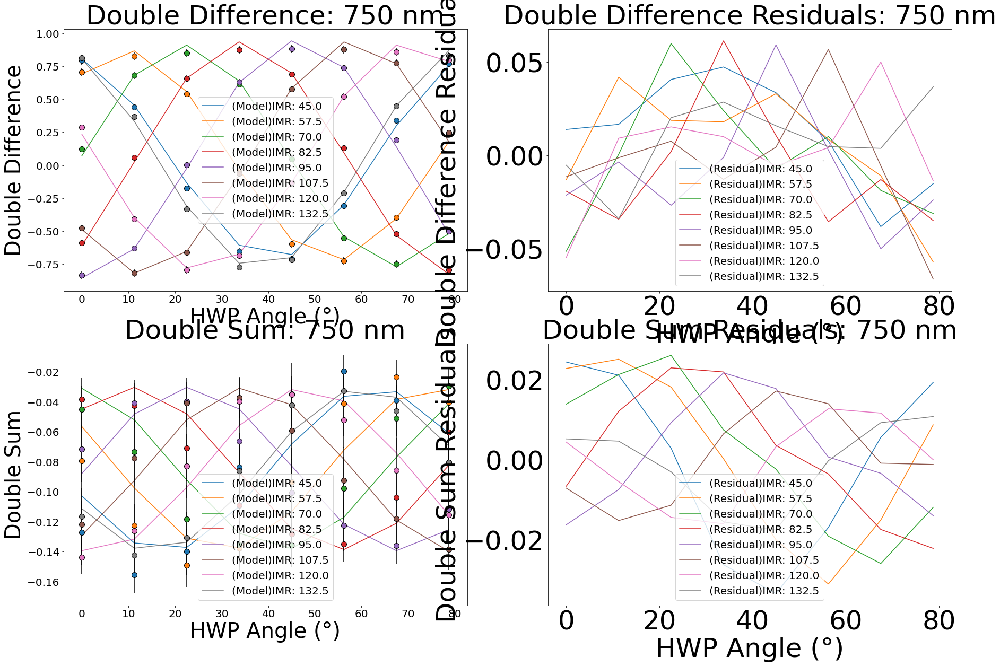

Post Likelihood: -1499.3533168377853
Initial Likelihood: 204.76435793212607
Iteration #3: -1565.068253048752
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.6778748138301944
delta_HWP (waves): 0.4697432751562891
offset_HWP (degrees): 4.99984071888546
delta_derot (waves): 0.4916086412244134
offset_derot (degrees): -4.999960867222654
delta_opts (waves): 0.26467655957831604
epsilon_opts: 1.2689189719885003e-06
rot_opts (degrees): -5.5274921830427015
delta_FLC (waves): 0.4846978423705781
rot_FLC (degrees): 4.999557460144608
em_gain: 1.1888001802534274


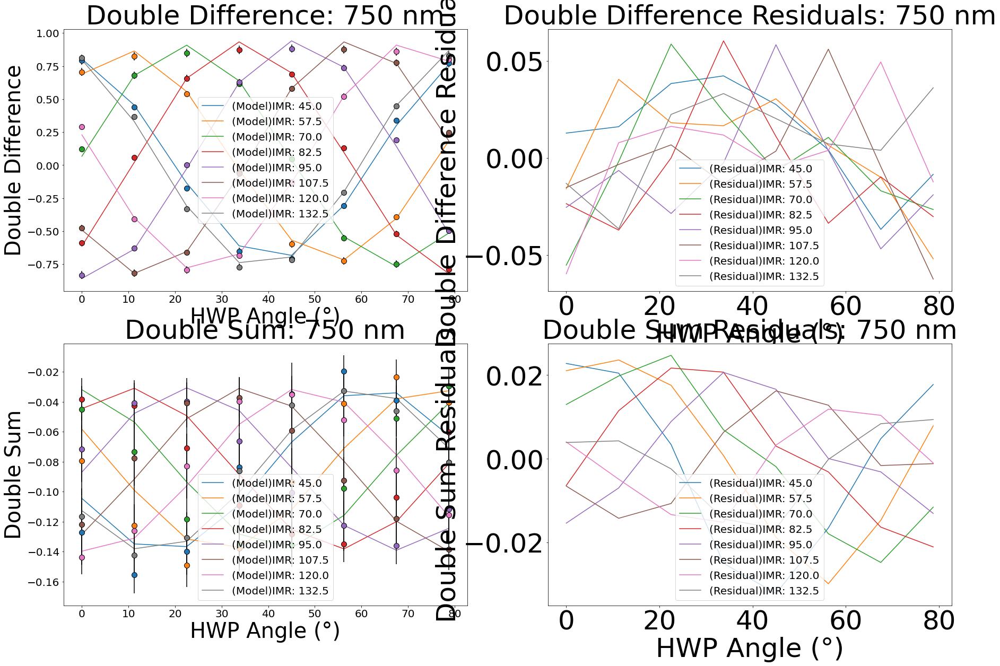

Post Likelihood: -1565.068253048752
Initial Likelihood: 198.1225361823904
Iteration #4: -1537.605103743154
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.6991292974038696
delta_HWP (waves): 0.46970113895009585
offset_HWP (degrees): 4.999994930267691
delta_derot (waves): 0.4916862482919807
offset_derot (degrees): -4.999992465993515
delta_opts (waves): 0.2645642778780085
epsilon_opts: 1.2947600804639818e-07
rot_opts (degrees): -5.518263782677584
delta_FLC (waves): 0.48465251946117993
rot_FLC (degrees): 4.999994387963925
em_gain: 1.188621441264825


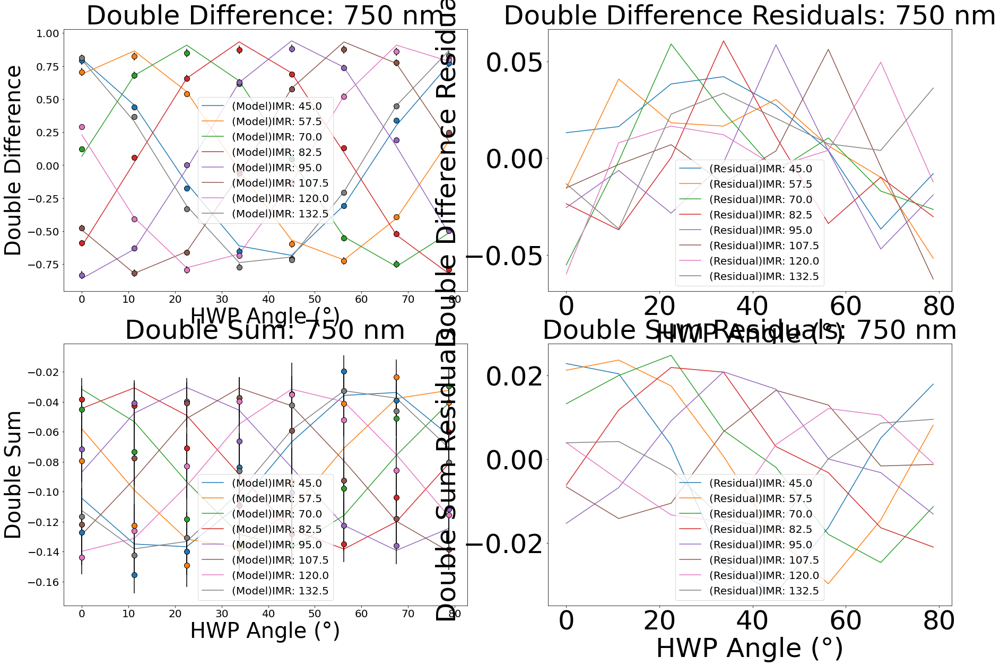

Post Likelihood: -1537.605103743154
Initial Likelihood: 198.10195670250008
Iteration #5: -1536.9748393965526
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7095959011658897
delta_HWP (waves): 0.46970419796640484
offset_HWP (degrees): 5.0
delta_derot (waves): 0.4916815968974684
offset_derot (degrees): -4.999999895687381
delta_opts (waves): 0.26447235290169135
epsilon_opts: 2.88963738249204e-09
rot_opts (degrees): -5.516807666784704
delta_FLC (waves): 0.4846525261211412
rot_FLC (degrees): 4.9999993371414515
em_gain: 1.1885930309653667


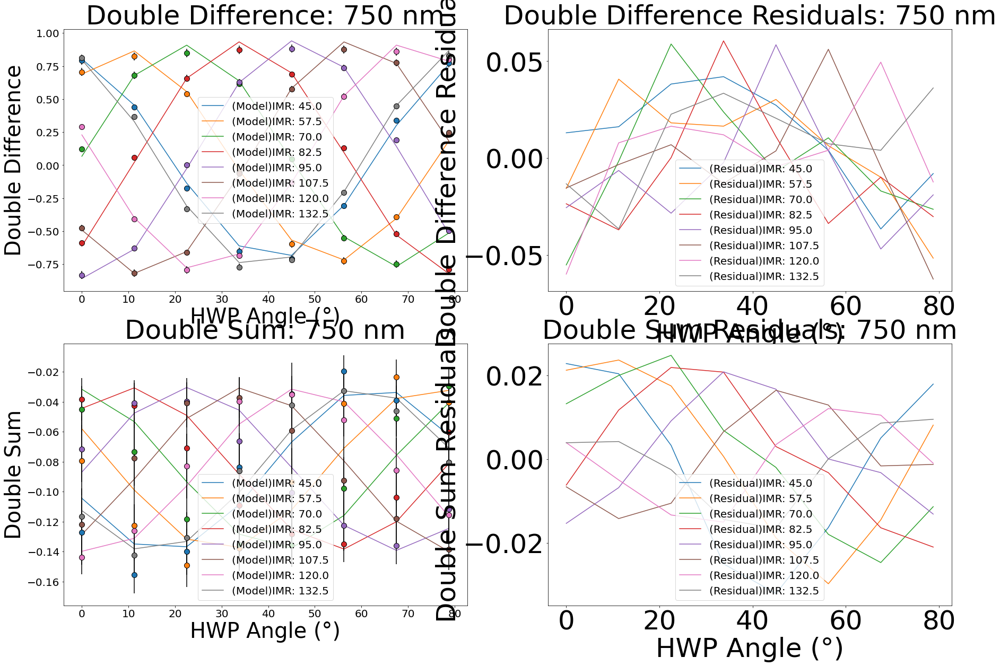

Post Likelihood: -1536.9748393965526
Initial Likelihood: 198.10118527313497
Iteration #6: -1536.1175603677364
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7077396730942507
delta_HWP (waves): 0.4697053223086183
offset_HWP (degrees): 4.999999961059794
delta_derot (waves): 0.4916820705409115
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448373774419587
epsilon_opts: 7.350184187780725e-11
rot_opts (degrees): -5.517433791933321
delta_FLC (waves): 0.48465306601828084
rot_FLC (degrees): 4.999999994444375
em_gain: 1.1885854437022454


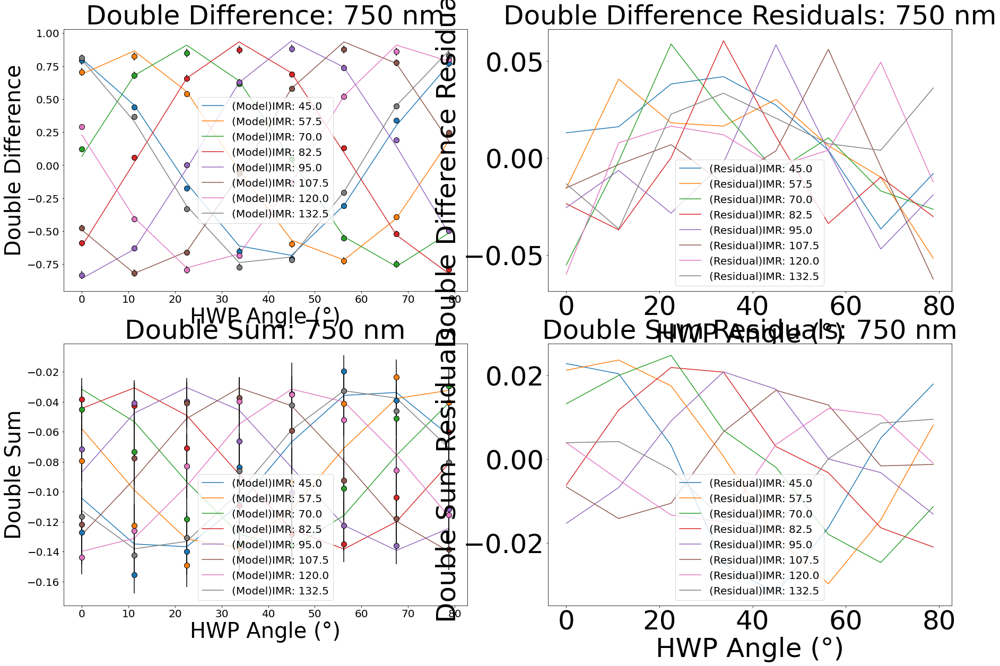

Post Likelihood: -1536.1175603677364
Initial Likelihood: 198.10115774170163
Iteration #7: -1536.21300099972
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7077184712089224
delta_HWP (waves): 0.4697051663356862
offset_HWP (degrees): 4.999999960350188
delta_derot (waves): 0.49168244347999535
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448424693068506
epsilon_opts: 7.318141079850159e-11
rot_opts (degrees): -5.517405208714825
delta_FLC (waves): 0.4846529157226546
rot_FLC (degrees): 4.9999999927039855
em_gain: 1.188586735836492


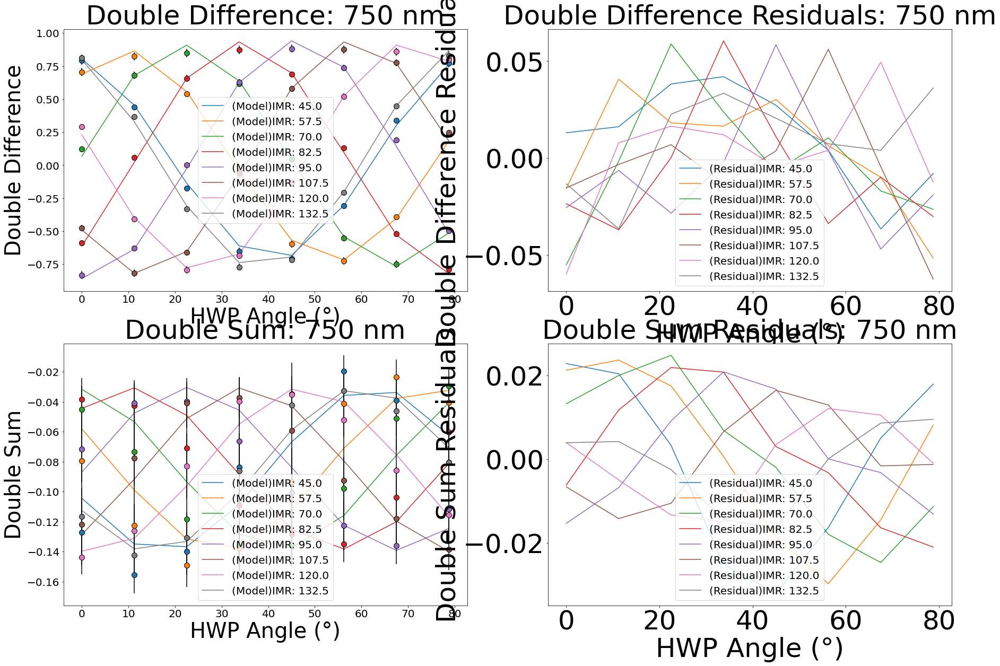

Post Likelihood: -1536.21300099972
Initial Likelihood: 198.10115756201571
Iteration #8: -1536.1067865719087
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7077175055772447
delta_HWP (waves): 0.46970498274485123
offset_HWP (degrees): 4.999999968064531
delta_derot (waves): 0.491682518558606
offset_derot (degrees): -5.0
delta_opts (waves): 0.2644844706652481
epsilon_opts: 7.440266725971286e-11
rot_opts (degrees): -5.517400482729981
delta_FLC (waves): 0.48465297302521043
rot_FLC (degrees): 4.999999994042364
em_gain: 1.188586289165991


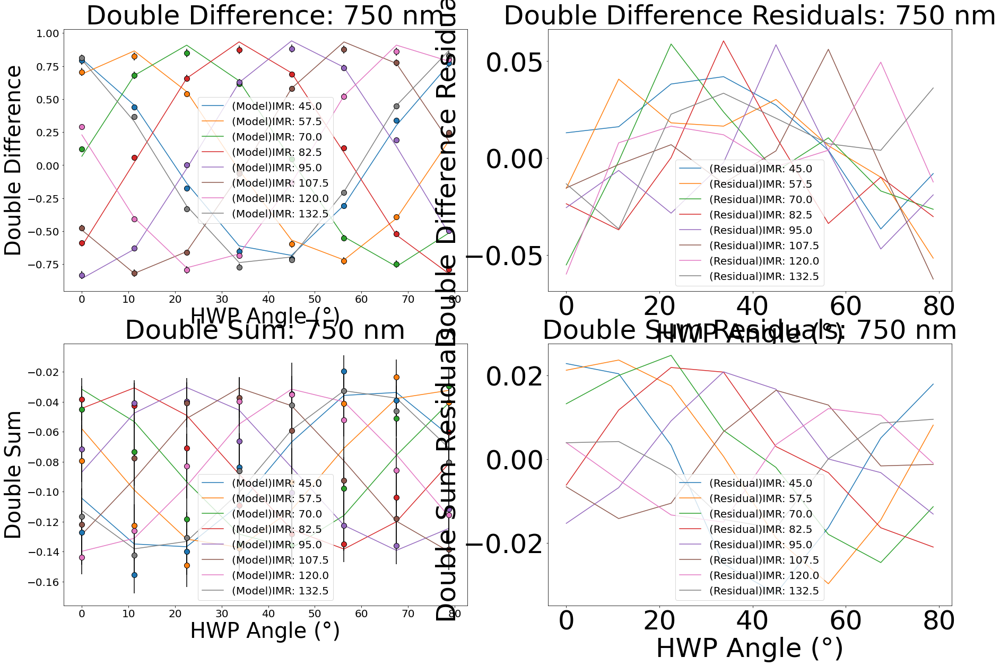

Post Likelihood: -1536.1067865719087
Initial Likelihood: 198.1011575436851
Iteration #9: -1536.0834341293253
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7077079843073926
delta_HWP (waves): 0.46970497118388643
offset_HWP (degrees): 4.999999979176208
delta_derot (waves): 0.49168232765105857
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448469199387414
epsilon_opts: 7.564421177631295e-11
rot_opts (degrees): -5.517362232090626
delta_FLC (waves): 0.4846529533047331
rot_FLC (degrees): 4.999999996155858
em_gain: 1.188585828443994


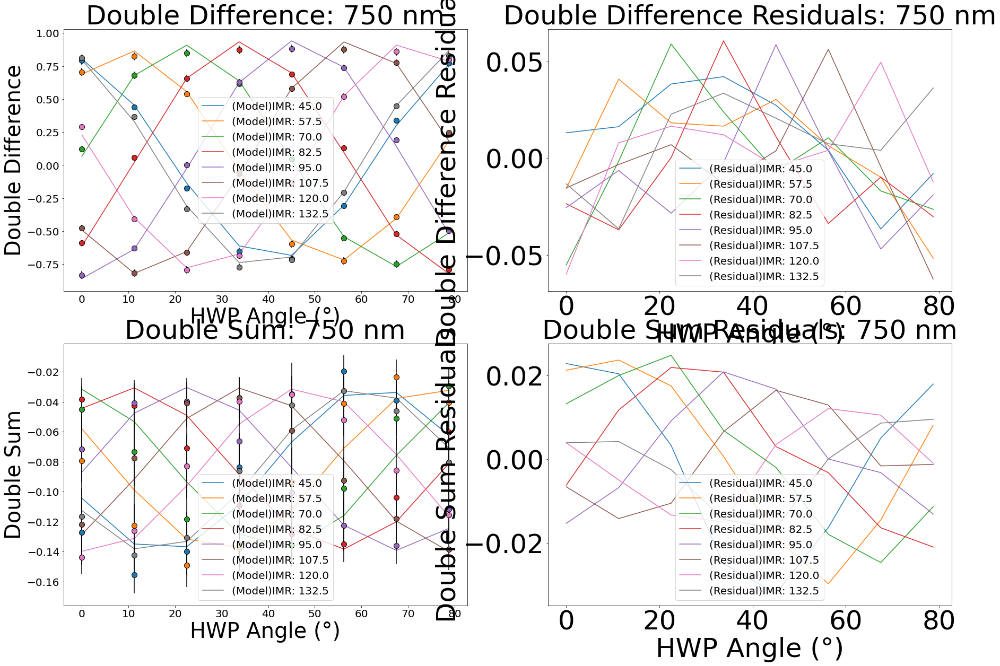

Post Likelihood: -1536.0834341293253
Initial Likelihood: 198.10115751301416
Iteration #10: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


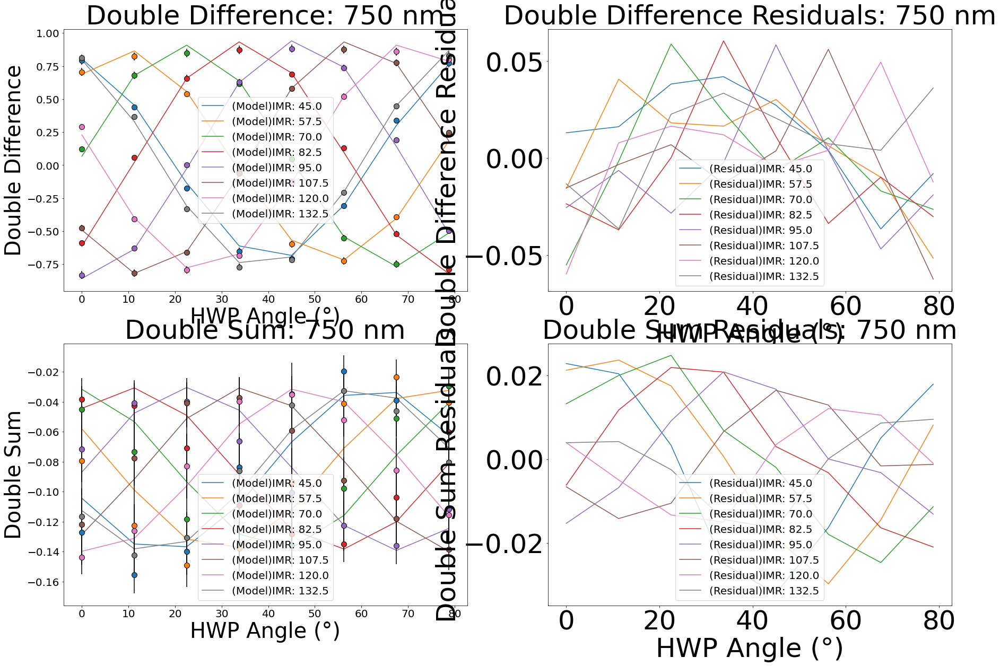

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #11: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


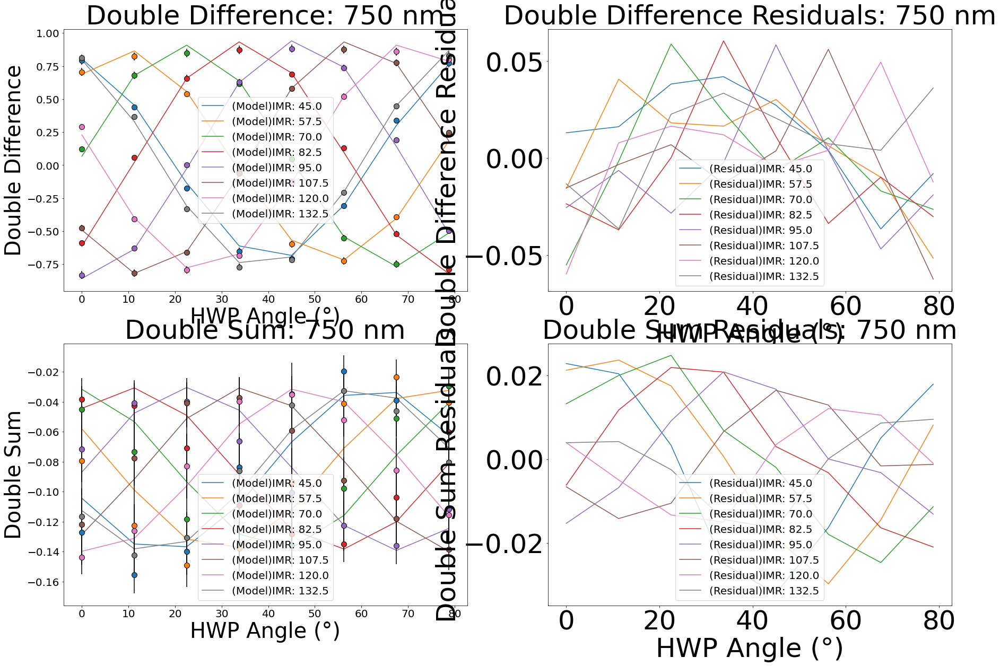

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #12: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


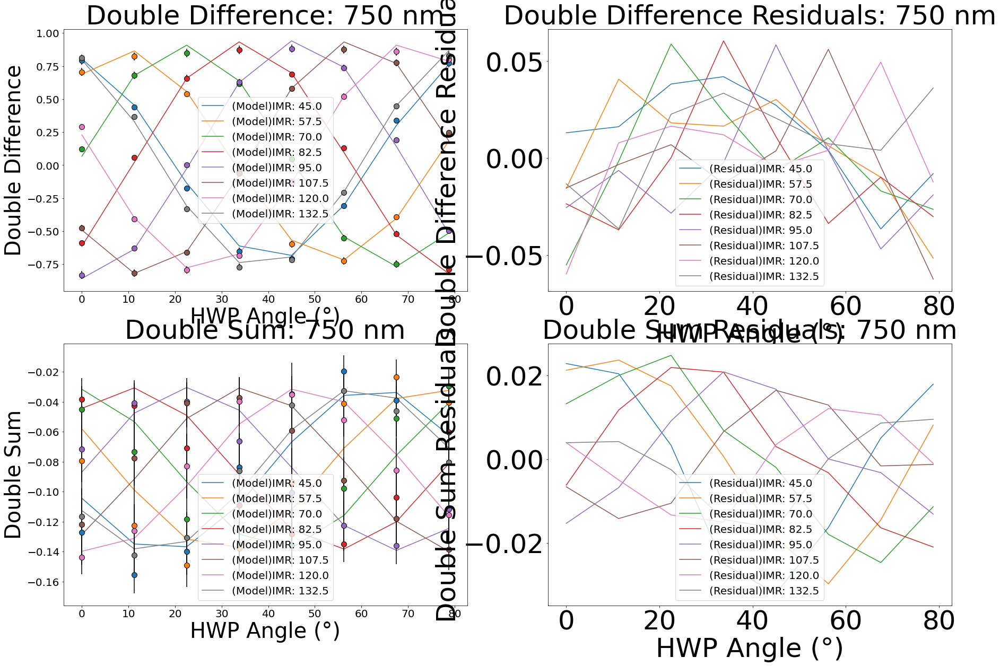

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #13: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


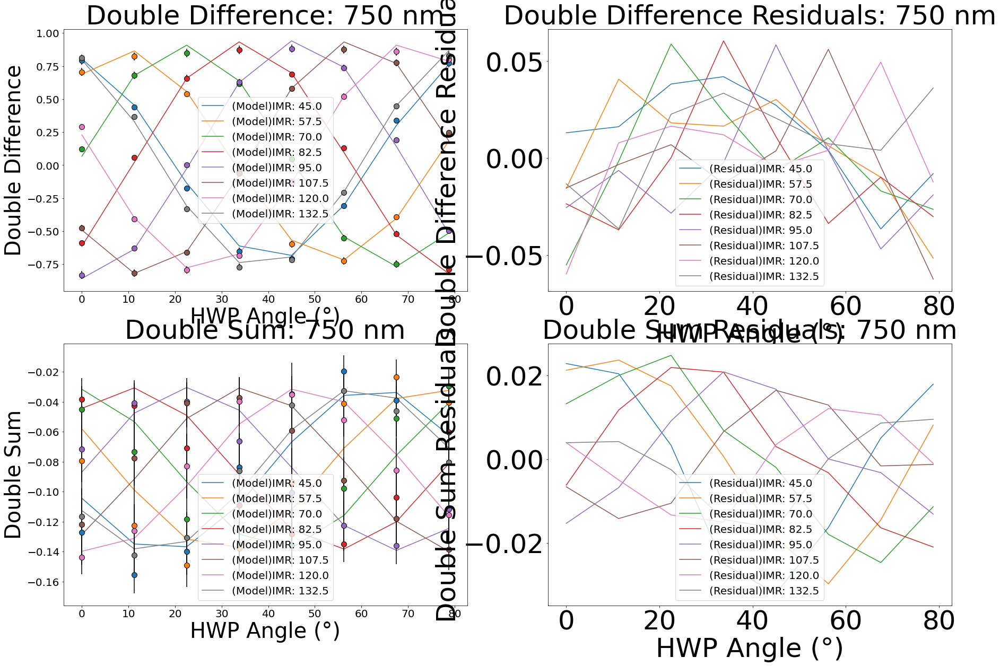

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #14: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


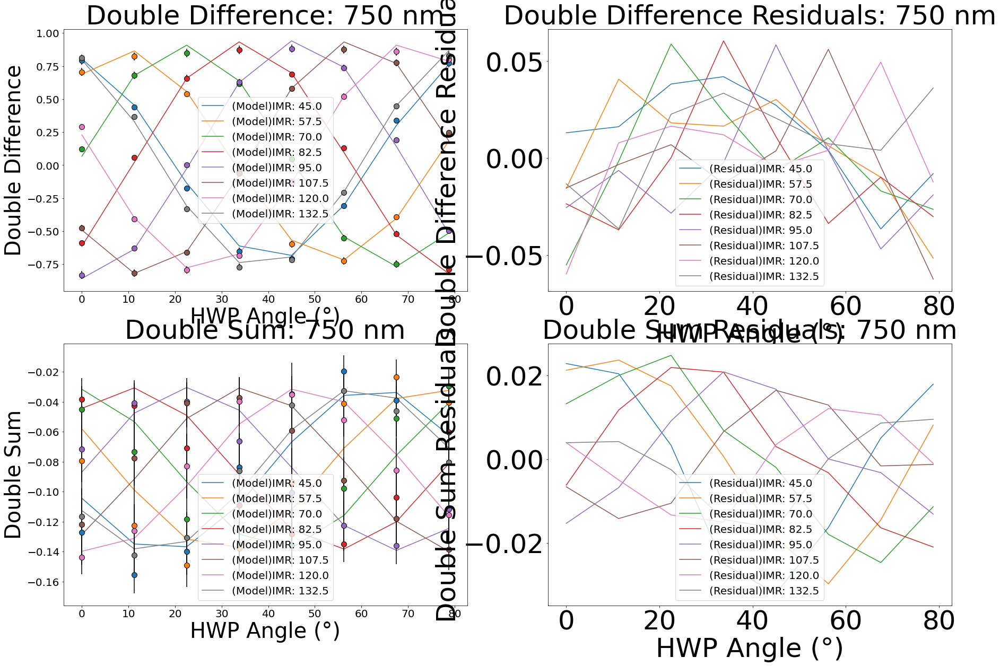

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #15: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


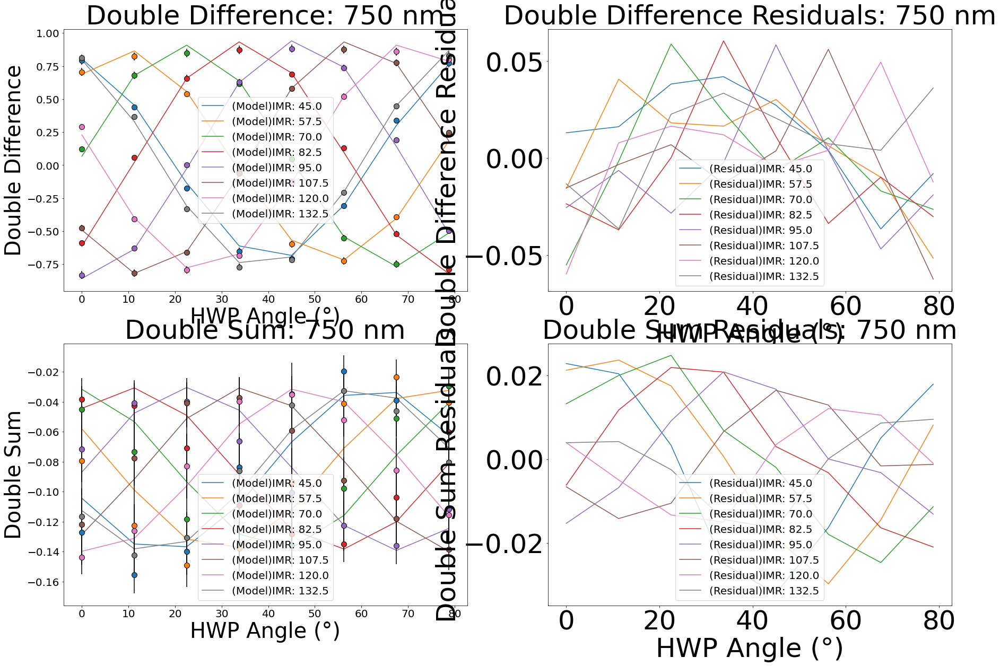

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #16: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


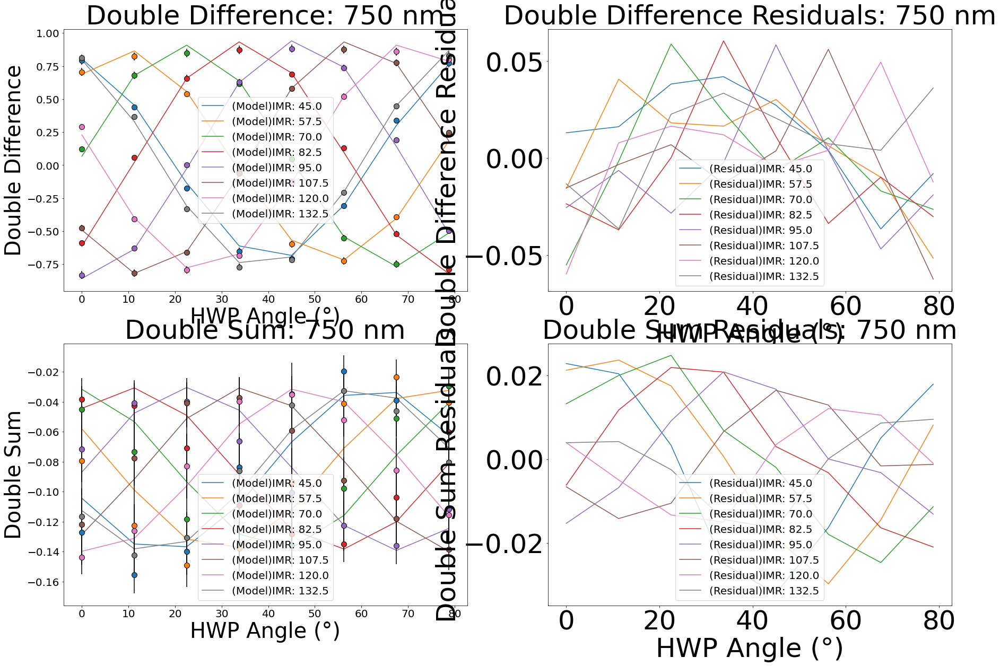

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #17: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


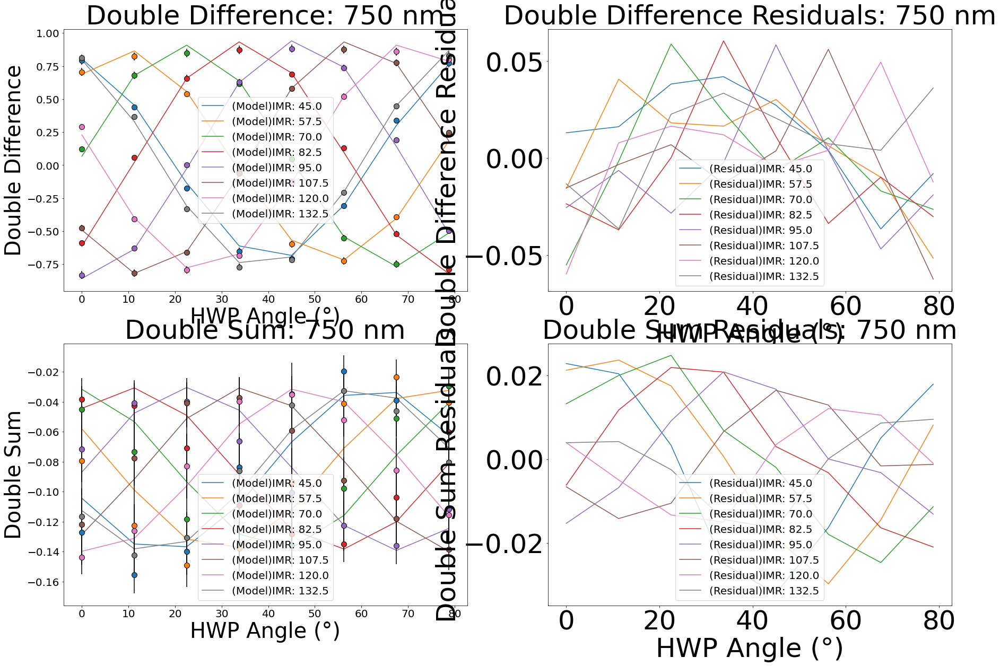

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #18: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


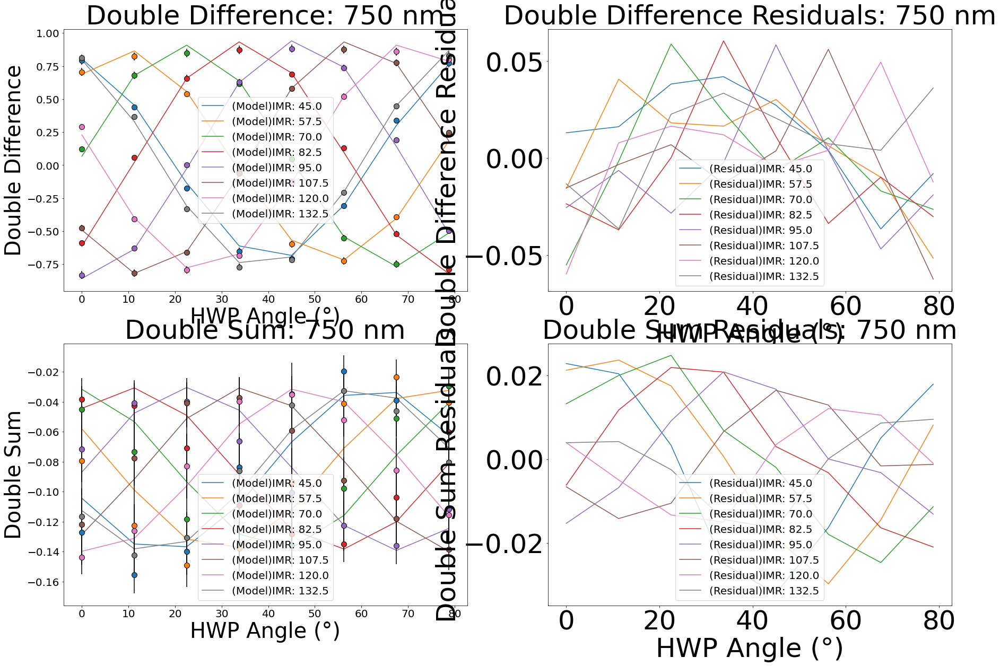

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #19: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


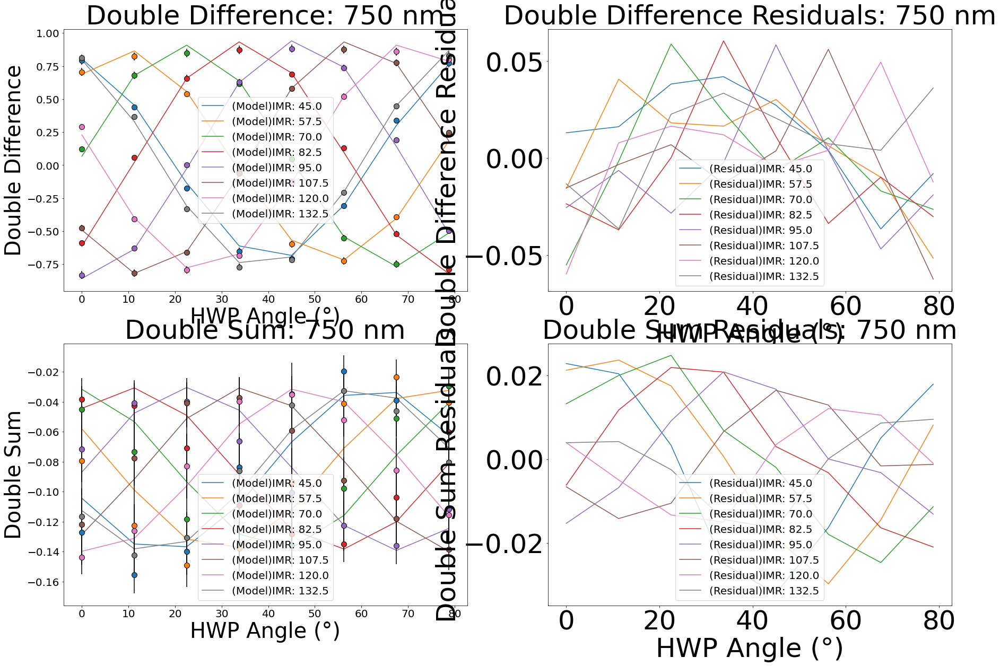

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #20: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


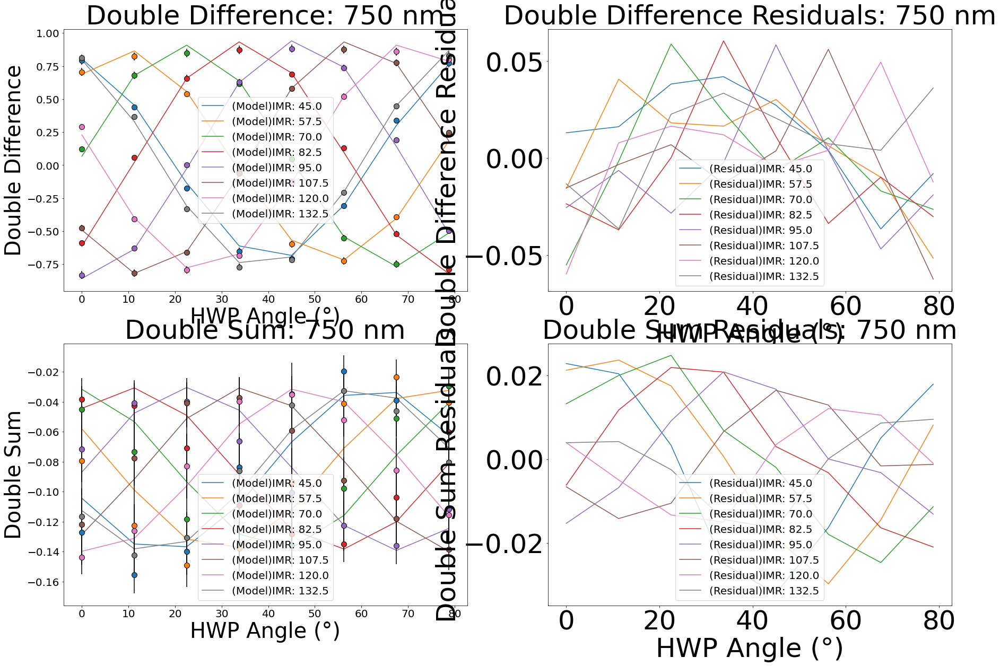

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #21: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


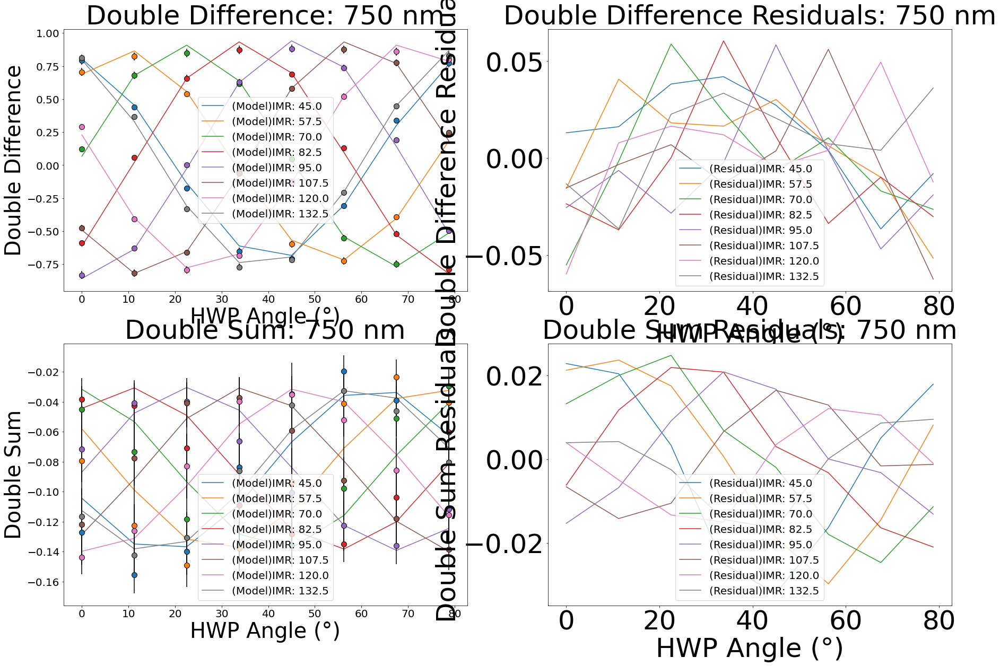

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #22: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


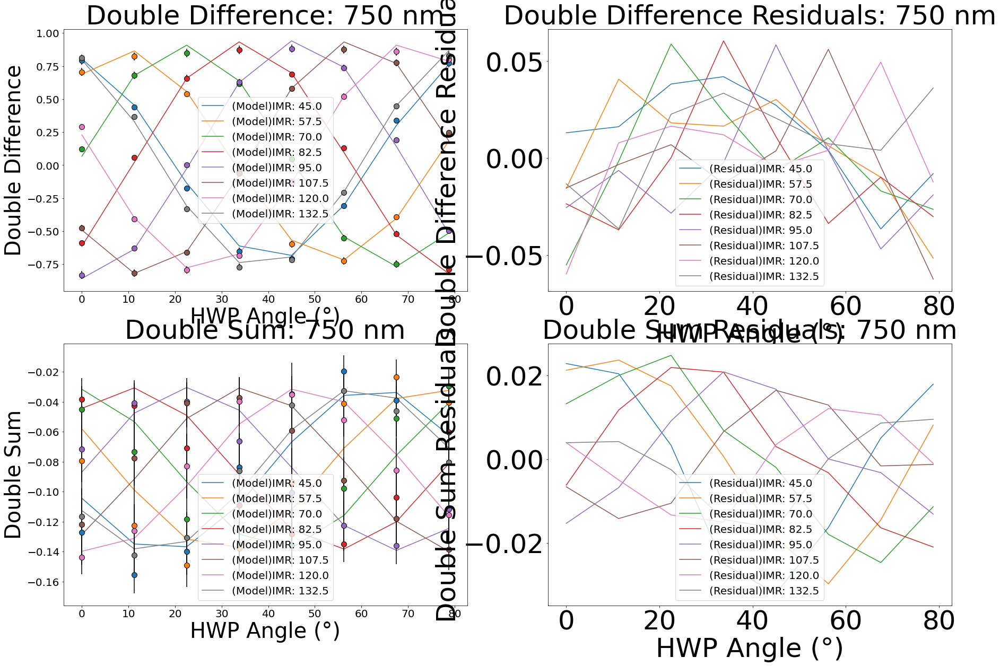

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #23: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


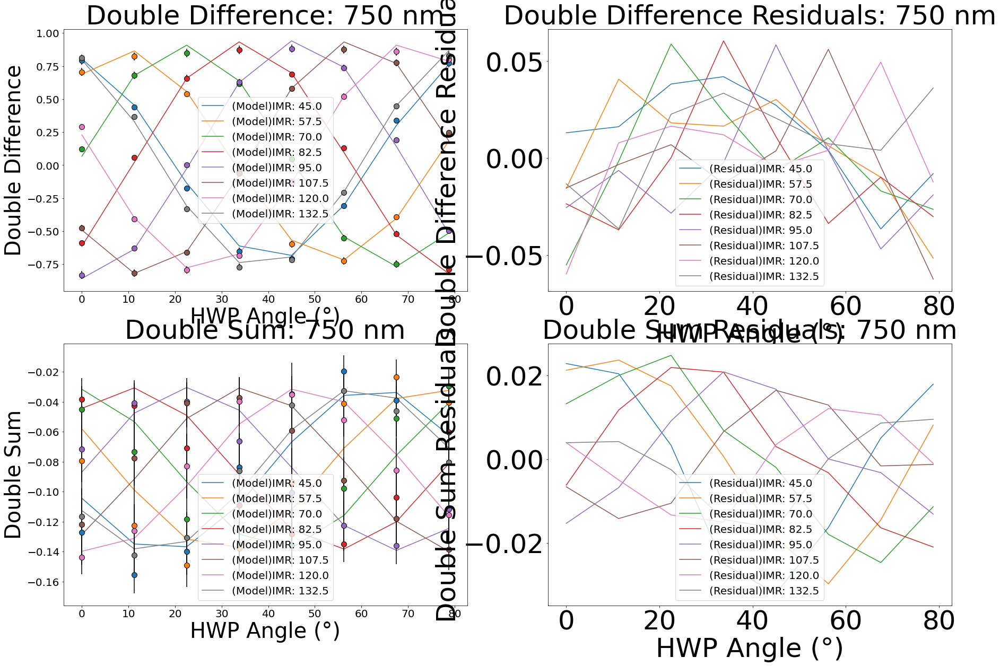

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #24: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


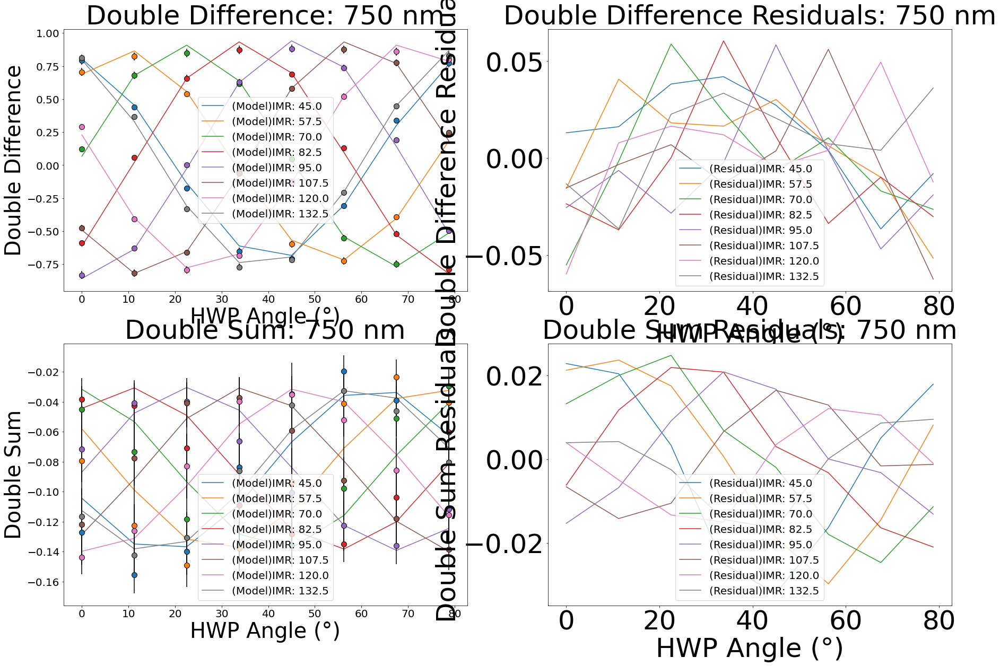

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #25: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


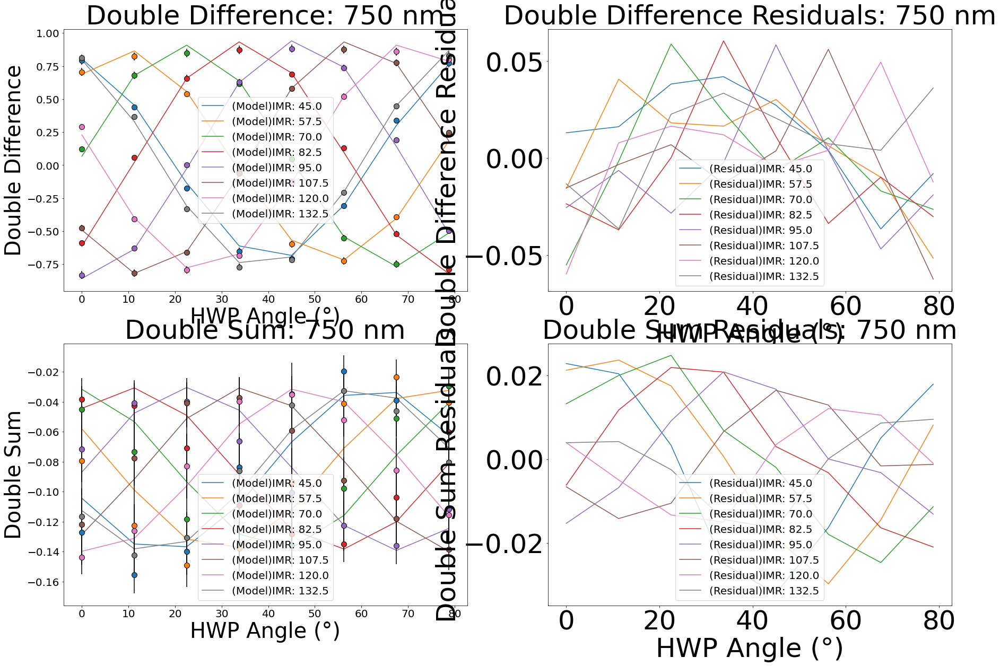

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #26: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


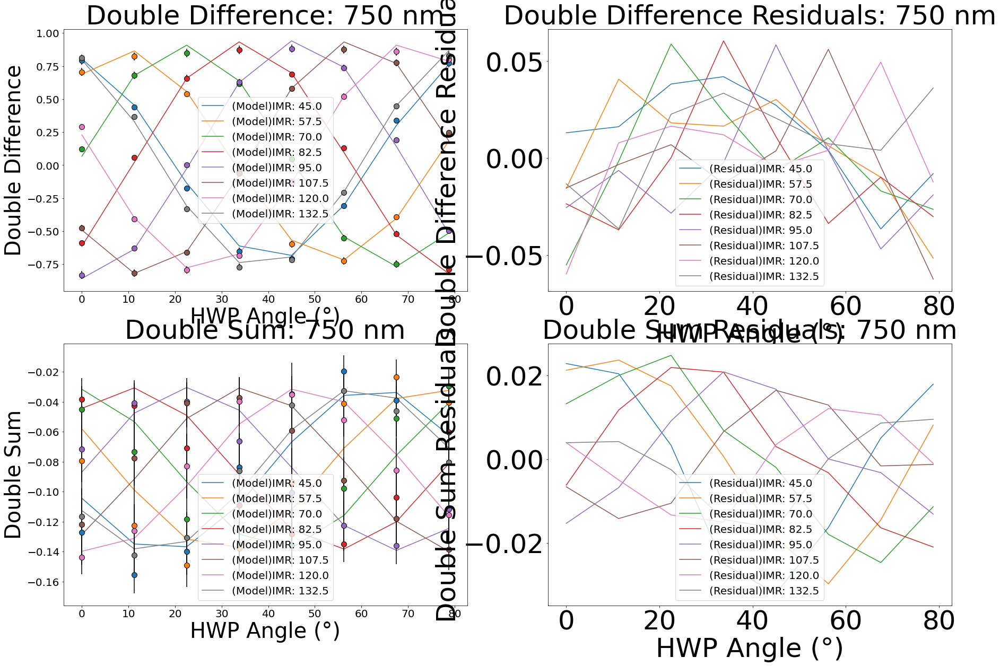

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #27: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


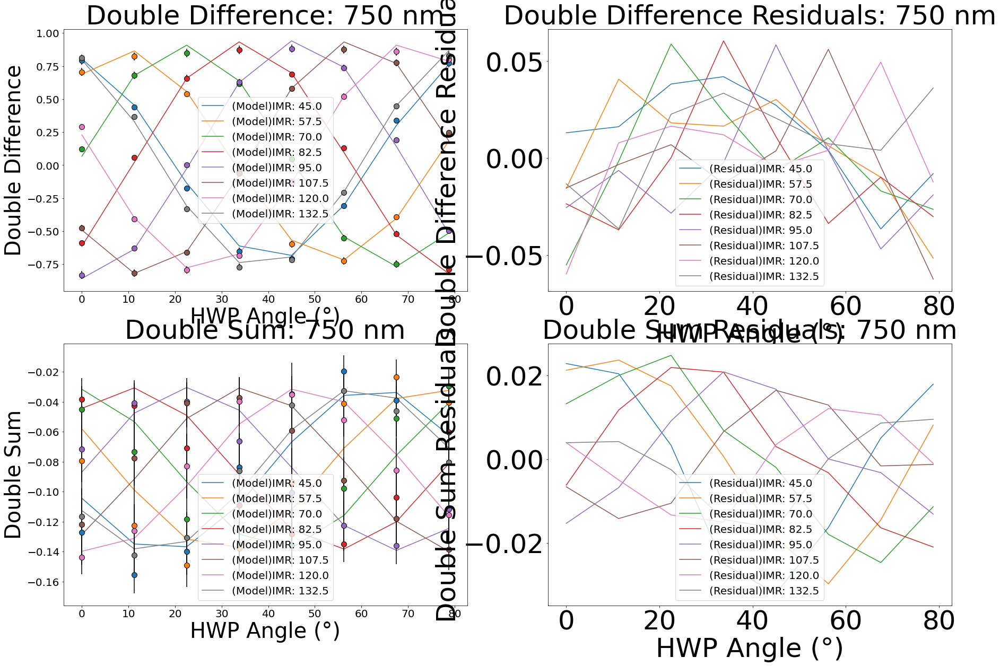

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #28: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


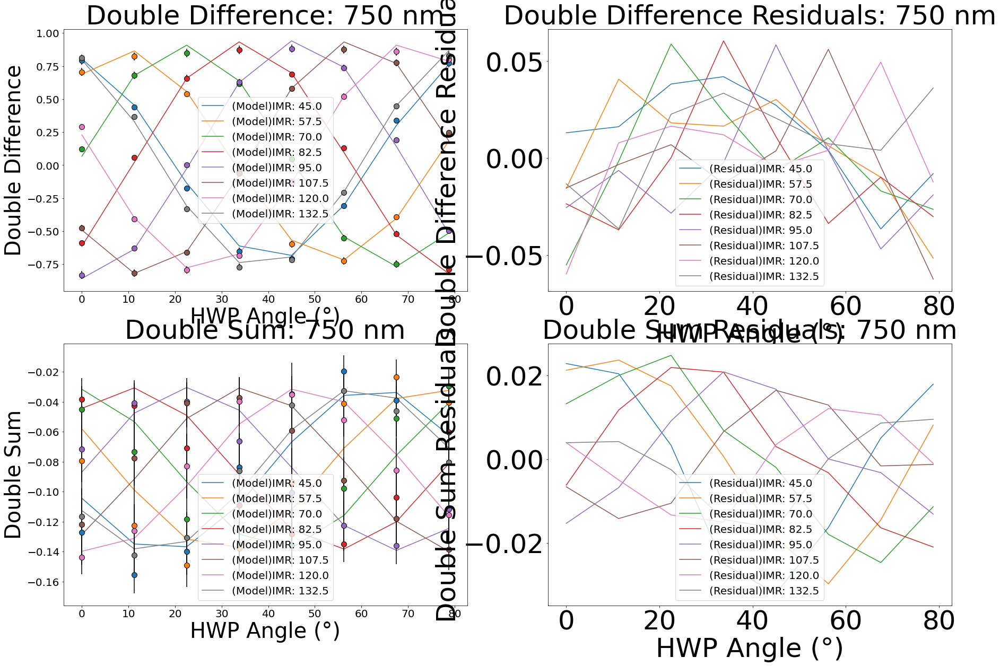

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #29: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


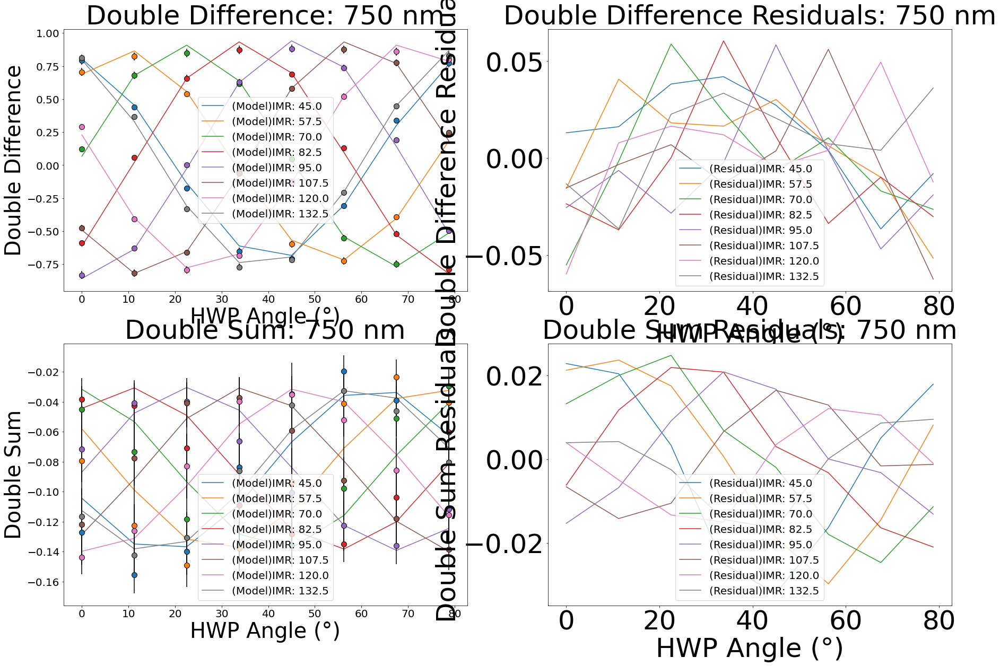

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #30: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


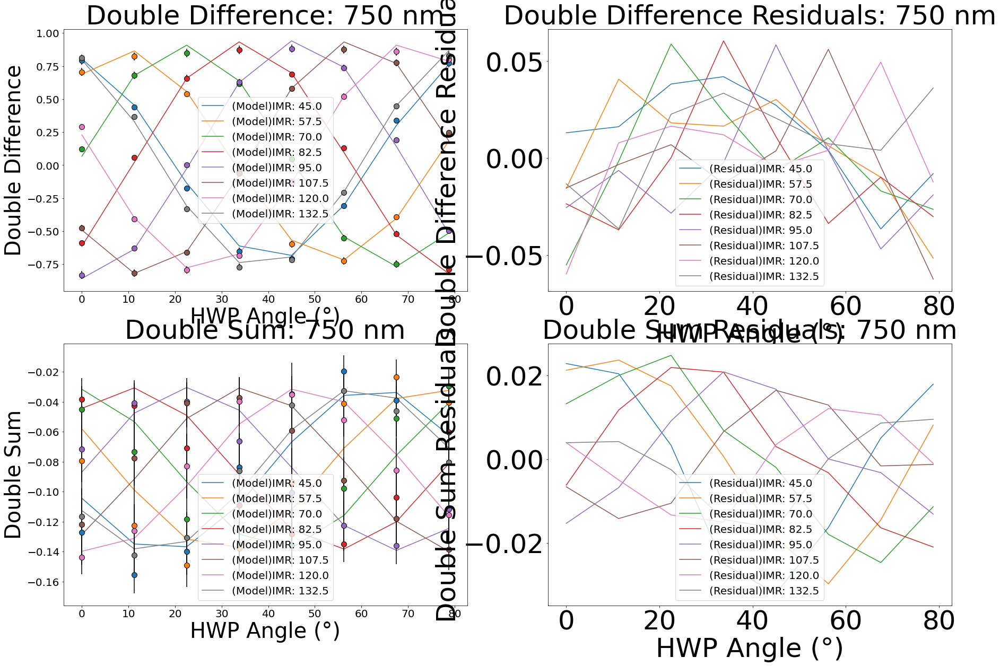

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #31: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


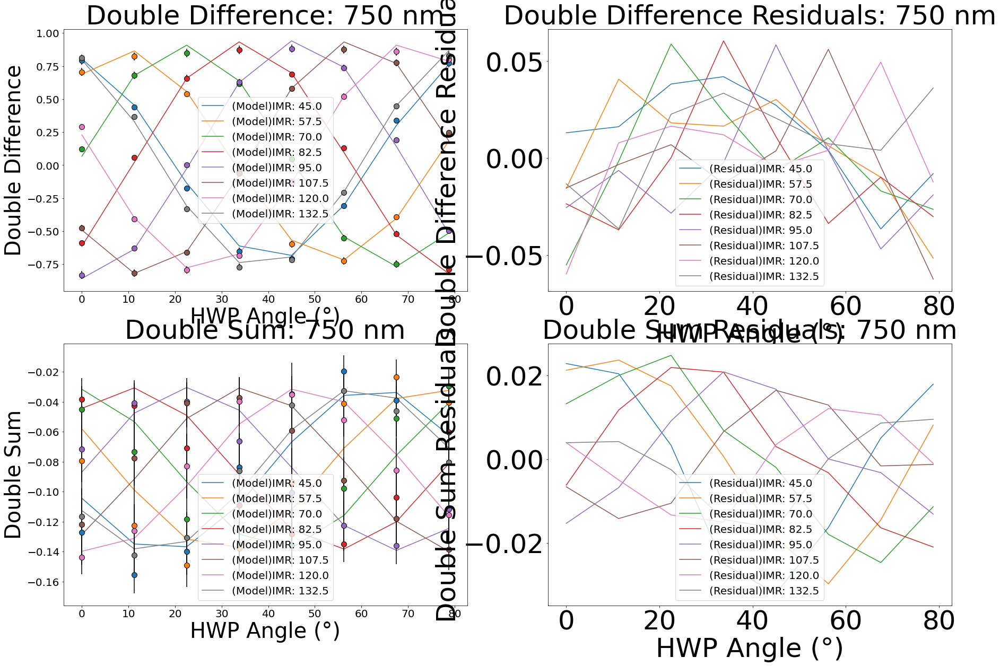

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #32: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


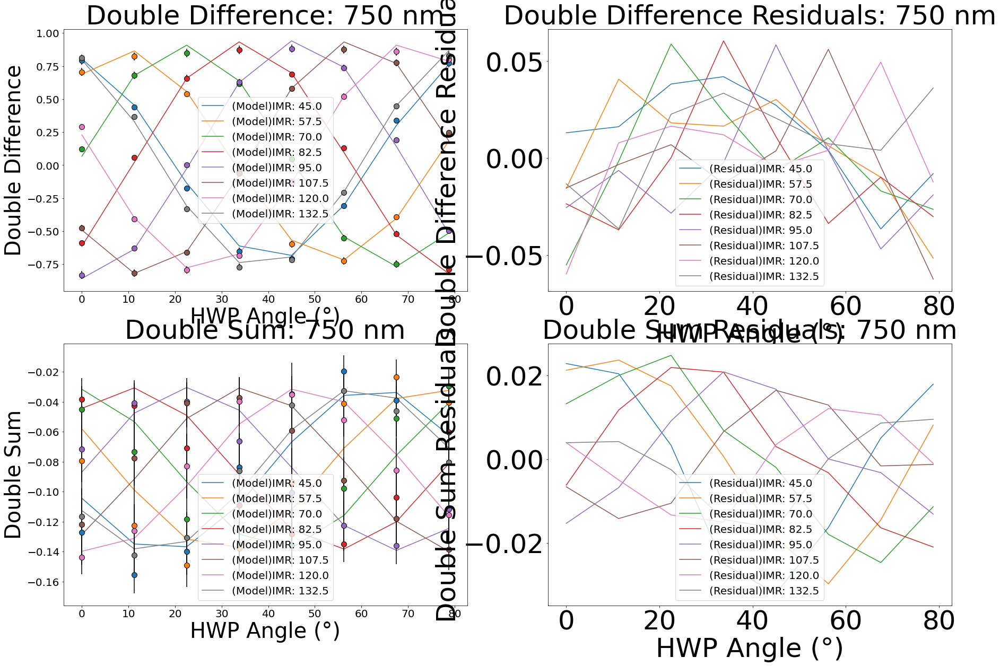

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #33: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


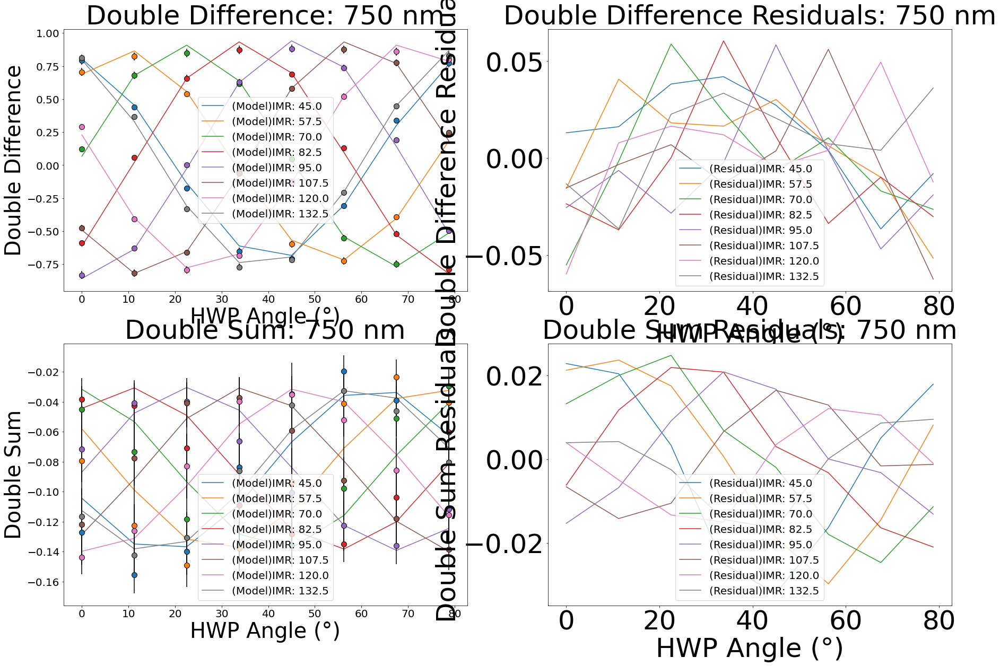

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658
Iteration #34: -1535.9949573835606
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 3.7076542079106227
delta_HWP (waves): 0.4697049286003256
offset_HWP (degrees): 4.999999990748636
delta_derot (waves): 0.4916825631067103
offset_derot (degrees): -5.0
delta_opts (waves): 0.26448475654868386
epsilon_opts: 7.690580740080888e-11
rot_opts (degrees): -5.517409523967533
delta_FLC (waves): 0.4846529161283035
rot_FLC (degrees): 4.999999998290983
em_gain: 1.1885854840108756


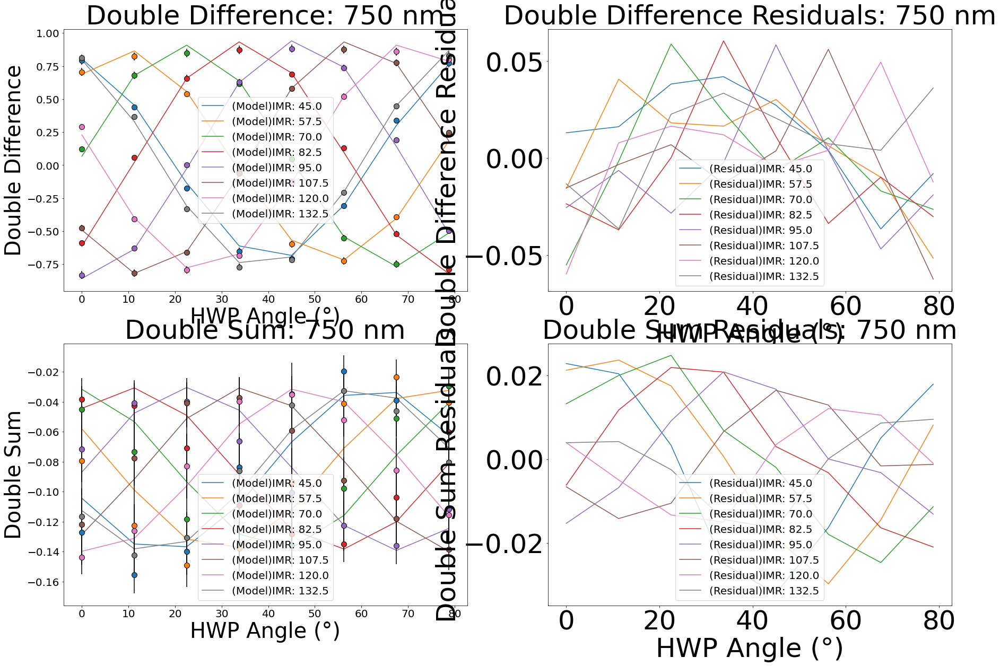

Post Likelihood: -1535.9949573835606
Initial Likelihood: 198.10115748390658


KeyboardInterrupt: 

In [9]:
import numpy as np
from scipy.optimize import minimize

# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# List to store all the solutions 
solns = []

# Initial guess based on the parameters you want to minimize
initial_guess = np.array([theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, 
    delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain])

all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Fixed parameters not included in the fitting process
fixed_params = [delta_m3, epsilon_m3, offset_m3]

# Initial Guess
theta_pol = 0
delta_m3 = 0 # (waves) - assumed to be a perfect mirror for now
epsilon_m3 = 0  # Using the M3 diattenuation from :all_unpolarized_standards_matrix_inversion_m3_diatttenuation"
offset_m3 = 0  # NOTE: Made this zero too for testing purposes
em_gain = 1.2  # Add your actual em_gain value
delta_HWP = 0.451  # Add your actual delta_HWP value
offset_HWP = -2.642  # Add your actual offset_HWP value
delta_derot = 0.32  # Add your actual delta_derot value
offset_derot = 0  # Add your actual offset_derot value
delta_opts = 0  # Add your actual delta_opts value
epsilon_opts = 0  # Add your actual epsilon_opts value
rot_opts = 0  # Add your actual rot_opts value
delta_FLC = 0.5  # Add your actual delta_FLC value
rot_FLC = 0  # Add your actual rot_FLC value

# Define the bounds for the parameters (including em_gain)
bounds = [
    (-5, 5),  # theta_pol
    (0, 0.5),  # delta_HWP
    (-5, 5),  # offset_HWP
    (0, 0.5),  # delta_derot
    (-5, 5),  # offset_derot
    (-0.5, 0.5),  # delta_opts
    (0, 0.1),  # epsilon_opts
    (-90, 90),  # rot_opts
    (0.4, 0.6),  # delta_FLC
    (-5, 5),  # rot_FLC
    (0, 2)  # em_gain
]

# Defining the negative log-likelihood function
def nll(params, model, HWP_angs, IMR_angs, data, stds):
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain = params
    delta_m3, epsilon_m3, offset_m3 = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    this_model = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals = this_model - data
    
    # Debug print shapes
    # print("Model shape:", this_model.shape)
    # print("Data shape:", data.shape)
    # print("Stds shape:", stds.shape)
    
    likelihood = np.sum((residuals / stds) ** 2)
    return likelihood

# Initialize variables for the iterative minimization process
counter = 0
initial_likelihood = 100
post_likelihood = 90

# Starting off with the initial guess
model = instrument_matrices.full_system_mueller_matrix
initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)

while post_likelihood < initial_likelihood:
    counter += 1

    initial_likelihood = post_likelihood

    # Calculate the initial model and residuals
    initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)
    initial_residuals = initial_model - reshaped_data

    initial_likelihood = np.sum((initial_residuals / reshaped_stds) ** 2)

    print("Initial Likelihood: " + str(initial_likelihood))

    # Minimize the negative log-likelihood
    minimize_args = (model, HWP_angs, IMR_angs, reshaped_data, reshaped_stds)
    soln = minimize(nll, initial_guess, args=minimize_args, bounds=bounds, method="Nelder-Mead")

    # Save the solution
    solns.append(soln)

    # Recalculate the likelihood with the new solution
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain = soln.x
    delta_m3, epsilon_m3, offset_m3 = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    post_likelihood = np.sum((-instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs) - reshaped_data) / reshaped_stds ** 2)

    print("Iteration #" + str(counter) + ": " + str(post_likelihood))

    print("MAXIMUM LIKELIHOOD ESTIMATES")
    print("")
    print("theta_pol (degrees): " + str(theta_pol))
    print("delta_HWP (waves): " + str(delta_HWP))
    print("offset_HWP (degrees): " + str(offset_HWP))
    print("delta_derot (waves): " + str(delta_derot))
    print("offset_derot (degrees): " + str(offset_derot))
    print("delta_opts (waves): " + str(delta_opts))
    print("epsilon_opts: " + str(epsilon_opts))
    print("rot_opts (degrees): " + str(rot_opts))
    print("delta_FLC (waves): " + str(delta_FLC))
    print("rot_FLC (degrees): " + str(rot_FLC))
    print("em_gain: " + str(em_gain))

    reshaped_data = general.reshape_and_flatten(data)
    reshaped_stds = general.reshape_and_flatten(stds)

    model_1 = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals_1 = model_1 - reshaped_data

    data_plotting.plot_single_model_and_residuals(angles, angles, model_1, data, 
        residuals_1, stds, log_f, wavelength, fig_dimensions = (30, 20))

    # Reset initial guess
    initial_guess = soln.x

    print("Post Likelihood: " + str(post_likelihood))

print("End of Optimization")


# Saving Final Fit

In [4]:
import numpy as np

scipy_minimize_20230914_750nm_restrictive_HWP_and_IMR = np.array(
    [3.70765421e+00,  4.69704929e-01,  4.99999999e+00,  4.91682563e-01, 
     -5.00000000e+00,  2.64484757e-01,  7.69058074e-11, -5.51740952e+00, 
     4.84652916e-01,  5.00000000e+00,  1.18858548e+00])

save_string = "scipy_minimize_20230914_750nm_restrictive_HWP_and_IMR.npy"
np.save("scipy_minimize_20230914_750nm_restrictive_HWP_and_IMR.npy", scipy_minimize_20230914_750nm_restrictive_HWP_and_IMR)

In [5]:
array = np.load(save_string)